# VegaLite.jl examples

In [1]:
using VegaLite, VegaDatasets, DataFrames

## Single-View Plots

### Bar Charts & Histograms

#### Simple Bar Chart

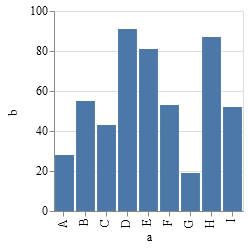

In [2]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A simple bar chart with embedded data.",
  "data": {
    "values": [
      {"a": "A","b": 28}, {"a": "B","b": 55}, {"a": "C","b": 43},
      {"a": "D","b": 91}, {"a": "E","b": 81}, {"a": "F","b": 53},
      {"a": "G","b": 19}, {"a": "H","b": 87}, {"a": "I","b": 52}
    ]
  },
  "mark": "bar",
  "encoding": {
    "x": {"field": "a", "type": "ordinal"},
    "y": {"field": "b", "type": "quantitative"}
  }
}
"""

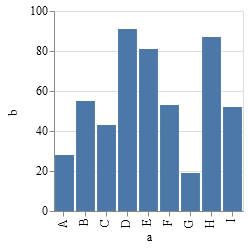

In [3]:
@vlplot(:bar,
    description="A simple bar chart with embedded data.",
    data={
        values=[
            {a="A",b=28}, {a="B",b=55}, {a="C",b=43},
            {a="D",b=91}, {a="E",b=81}, {a="F",b=53},
            {a="G",b=19}, {a="H",b=87}, {a="I",b=52}
        ]
    },
    enc={x="a:o",y="b:q"}
)

#### Histogram

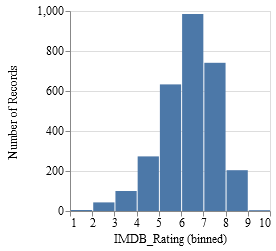

In [4]:
dataset("movies") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "bar",
  "encoding": {
    "x": {
      "bin": true,
      "field": "IMDB_Rating",
      "type": "quantitative"
    },
    "y": {
      "aggregate": "count",
      "type": "quantitative"
    }
  }
}
"""

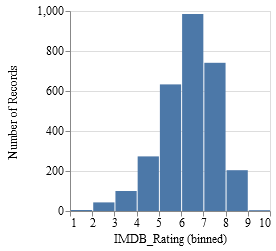

In [5]:
dataset("movies") |> @vlplot(:bar,enc={x={"IMDB_Rating:q", bin=true},y="count():q"})

#### Aggregate Bar Chart

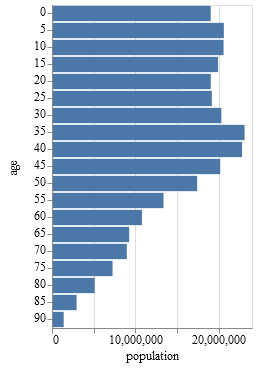

In [6]:
dataset("population") |>  vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A bar chart showing the US population distribution of age groups in 2000.",
  "transform": [{"filter": "datum.year == 2000"}],
  "mark": "bar",
  "encoding": {
    "y": {
      "field": "age", "type": "ordinal",
      "scale": {"rangeStep": 17}
    },
    "x": {
      "aggregate": "sum", "field": "people", "type": "quantitative",
      "axis": {"title": "population"}
    }
  }
}
"""

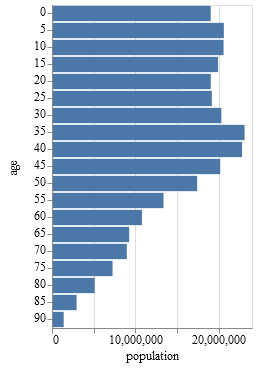

In [7]:
dataset("population") |> @vlplot(:bar,
    transform=[{filter="datum.year == 2000"}],
    enc={
        y={"age:o",scale={rangeStep=17}},
        x={"sum(people):q",axis={title="population"}}
    }
)

#### Grouped Bar Chart

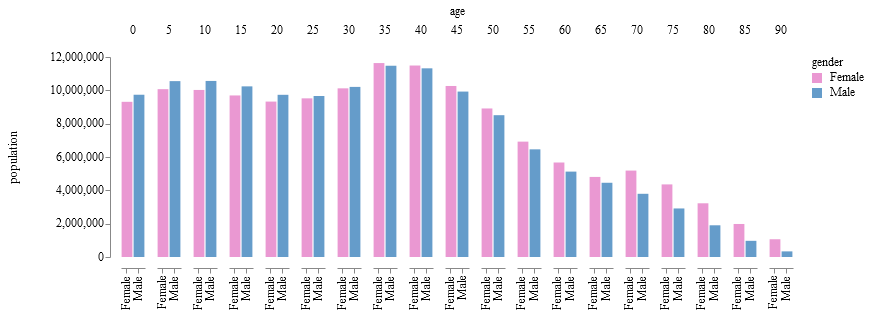

In [8]:
dataset("population") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "transform": [
    {"filter": "datum.year == 2000"},
    {"calculate": "datum.sex == 2 ? 'Female' : 'Male'", "as": "gender"}
  ],
  "mark": "bar",
  "encoding": {
    "column": {
      "field": "age", "type": "ordinal"
    },
    "y": {
      "aggregate": "sum", "field": "people", "type": "quantitative",
      "axis": {"title": "population", "grid": false}
    },
    "x": {
      "field": "gender", "type": "nominal",
      "scale": {"rangeStep": 12},
      "axis": {"title": ""}
    },
    "color": {
      "field": "gender", "type": "nominal",
      "scale": {"range": ["#EA98D2", "#659CCA"]}
    }
  },
  "config": {
    "view": {"stroke": "transparent"},
    "axis": {"domainWidth": 1}
  }
}
"""

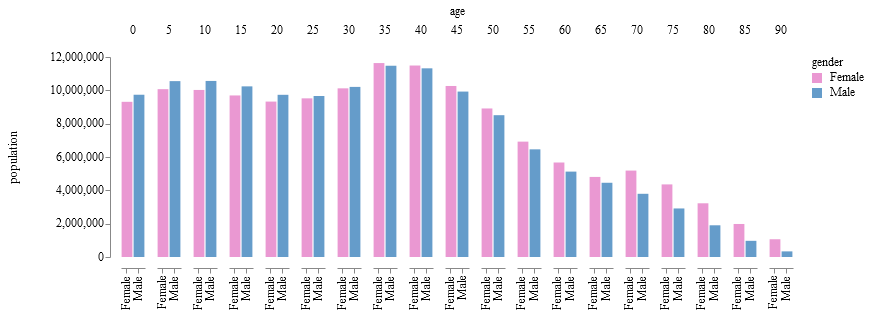

In [9]:
dataset("population") |> @vlplot(:bar,
    transform=[
        {filter="datum.year == 2000"},
        {calculate="datum.sex == 2 ? 'Female' : 'Male'", as="gender"}
    ],
    enc={
        column="age:o",
        y={"sum(people):q",axis={title="population",grid=false}},
        x={"gender:n",scale={rangeStep=12},axis={title=""}},
        color={"gender:n",scale={range=["#EA98D2", "#659CCA"]}},
    },
    config={
        view={stroke=:transparent},
        axis={domainWidth=1}
    }
)

#### Stacked Bar Chart

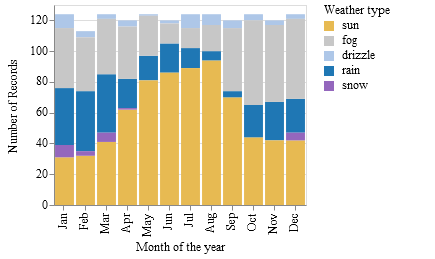

In [10]:
dataset("seattle-weather") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "bar",
  "encoding": {
    "x": {
      "timeUnit": "month",
      "field": "date",
      "type": "ordinal",
      "axis": {"title": "Month of the year"}
    },
    "y": {
      "aggregate": "count",
      "type": "quantitative"
    },
    "color": {
      "field": "weather",
      "type": "nominal",
      "scale": {
        "domain": ["sun","fog","drizzle","rain","snow"],
        "range": ["#e7ba52","#c7c7c7","#aec7e8","#1f77b4","#9467bd"]
      },
      "legend": {"title": "Weather type"}
    }
  }
}
"""

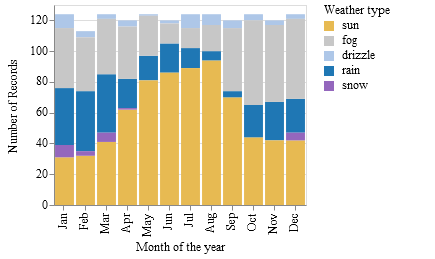

In [11]:
dataset("seattle-weather") |> @vlplot(:bar, enc={
    x={"month(date):o",axis={title="Month of the year"}},
    y="count():q",
    color={"weather:n",scale={domain=["sun","fog","drizzle","rain","snow"],range=["#e7ba52","#c7c7c7","#aec7e8","#1f77b4","#9467bd"]},legend={title="Weather type"}}
    })

#### Horizontal Stacked Bar Chart

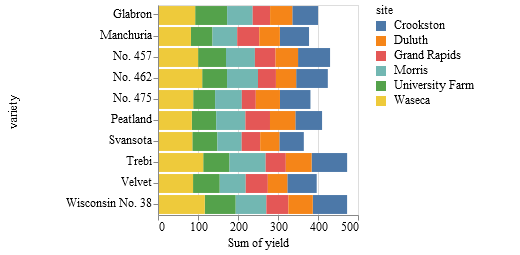

In [12]:
dataset("barley") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "bar",
  "encoding": {
    "x": {"aggregate": "sum", "field": "yield", "type": "quantitative"},
    "y": {"field": "variety", "type": "nominal"},
    "color": {"field": "site", "type": "nominal"}
  }
}
"""

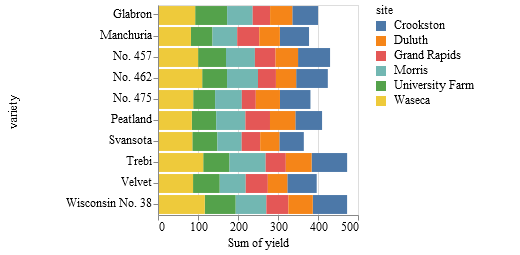

In [13]:
dataset("barley") |> @vlplot(:bar,enc={x="sum(yield):q",y="variety:n",color="site:n"})

#### Normalized Stacked Bar Chart

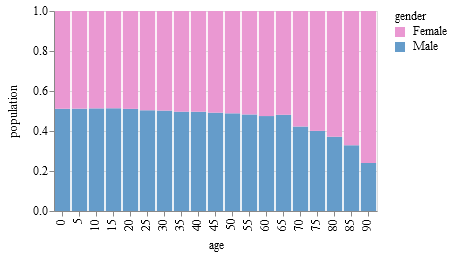

In [14]:
dataset("population") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "transform": [
    {"filter": "datum.year == 2000"},
    {"calculate": "datum.sex == 2 ? 'Female' : 'Male'", "as": "gender"}
  ],
  "mark": "bar",
  "encoding": {
    "y": {
      "aggregate": "sum", "field": "people", "type": "quantitative",
      "axis": {"title": "population"},
      "stack":  "normalize"
    },
    "x": {
      "field": "age", "type": "ordinal",
      "scale": {"rangeStep": 17}
    },
    "color": {
      "field": "gender", "type": "nominal",
      "scale": {"range": ["#EA98D2", "#659CCA"]}
    }
  }
}
"""

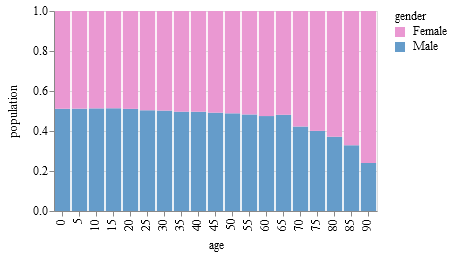

In [15]:
dataset("population") |> @vlplot(:bar,
    transform=[
        {filter="datum.year == 2000"},
        {calculate="datum.sex==2 ? 'Female' : 'Male'",as="gender"}
    ],
    enc={
        y={"sum(people):q",axis={title="population"},stack=:normalize},
        x={"age:o",scale={rangeStep=17}},
        color={"gender:n",scale={range=["#EA98D2", "#659CCA"]}}
    }
)

#### Gantt Chart (Ranged Bar Marks)

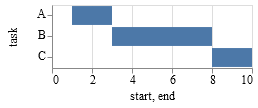

In [16]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A simple bar chart with ranged data (aka Gantt Chart).",
  "data": {
    "values": [
      {"task": "A","start": 1, "end": 3},
      {"task": "B","start": 3, "end": 8},
      {"task": "C","start": 8, "end": 10}
    ]
  },
  "mark": "bar",
  "encoding": {
    "y": {"field": "task", "type": "ordinal"},
    "x": {"field": "start", "type": "quantitative"},
    "x2": {"field": "end", "type": "quantitative"}
  }
}
"""

Note, we had to change the name ``end`` to ``stop`` here.

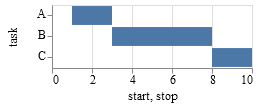

In [17]:
@vlplot(:bar,
    data={
        values=[
            {task="A",start=1,stop=3},
            {task="B",start=3,stop=8},
            {task="C",start=8,stop=10}
        ]
    },
    enc={y="task:o",x="start:q",x2="stop:q"})

#### A bar chart encoding color names in the data

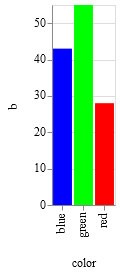

In [18]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A bar chart that directly encodes color names in the data.",
  "data": {
    "values": [
      {
        "color": "red",
        "b": 28
      },
      {
        "color": "green",
        "b": 55
      },
      {
        "color": "blue",
        "b": 43
      }
    ]
  },
  "mark": "bar",
  "encoding": {
    "x": {
      "field": "color",
      "type": "nominal"
    },
    "y": {
      "field": "b",
      "type": "quantitative"
    },
    "color": {
      "field": "color",
      "type": "nominal",
      "scale": null
    }
  }
}
"""

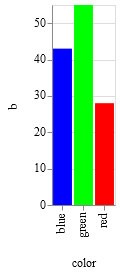

In [19]:
@vlplot(:bar,
    data={values=[{color="red",b=28},{color="green",b=55},{color="blue",b=43}]},
    enc={x="color:n",y="b:q",color={"color:n",scale=nothing}}
)

#### Layered Bar Chart

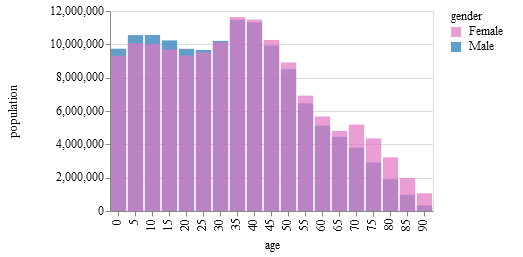

In [20]:
dataset("population") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A bar chart showing the US population distribution of age groups and gender in 2000.",
  "transform": [
    {"filter": "datum.year == 2000"},
    {"calculate": "datum.sex == 2 ? 'Female' : 'Male'", "as": "gender"}
  ],
  "mark": "bar",
  "encoding": {
    "x": {
      "field": "age", "type": "ordinal",
      "scale": {"rangeStep": 17}
    },
    "y": {
      "aggregate": "sum", "field": "people", "type": "quantitative",
      "axis": {"title": "population"},
      "stack": null
    },
    "color": {
      "field": "gender", "type": "nominal",
      "scale": {"range": ["#e377c2","#1f77b4"]}
    },
    "opacity": {"value": 0.7}
  }
}
"""

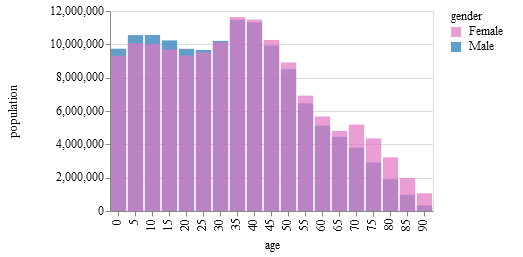

In [21]:
dataset("population") |> @vlplot(:bar,
    transform=[
        {filter="datum.year==2000"},
        {calculate="datum.sex==2 ? 'Female' : 'Male'",as="gender"}
    ],
    enc={
        x={"age:o",scale={rangeStep=17}},
        y={"sum(people):q",axis={title="population"},stack=nothing},
        color={"gender:n",scale={range=["#e377c2","#1f77b4"]}},
        opacity={value=0.7}
    }
)

#### Diverging Stacked Bar Chart (TODO)

#### Simple Bar Chart with Labels

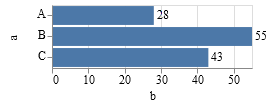

In [22]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A simple bar chart with embedded data.",
  "data": {
    "values": [
      {"a": "A","b": 28},
      {"a": "B","b": 55},
      {"a": "C","b": 43}
    ]
  },
  "encoding": {
    "y": {"field": "a", "type": "ordinal"},
    "x": {"field": "b", "type": "quantitative"}
  },
  "layer": [{
    "mark": "bar"
  }, {
    "mark": {
      "type": "text",
      "align": "left",
      "baseline": "middle",
      "dx": 3
    },
    "encoding": {
      "text": {"field": "b", "type": "quantitative"}
    }
  }]
}
"""

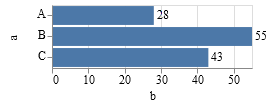

In [23]:
@vlplot(data={values=[{a="A",b=28},{a="B",b=55},{a="C",b=43}]},enc={y="a:o",x="b:q"}) +
@vlplot(:bar) +
@vlplot(mark={:text,align=:left,baseline=:middle,dx=3},enc={text="b:q"})

### Scatter & Strip Plots

#### Scatterplot

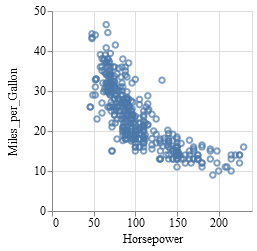

In [24]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A scatterplot showing horsepower and miles per gallons for various cars.",
  "mark": "point",
  "encoding": {
    "x": {"field": "Horsepower","type": "quantitative"},
    "y": {"field": "Miles_per_Gallon","type": "quantitative"}
  }
}
"""

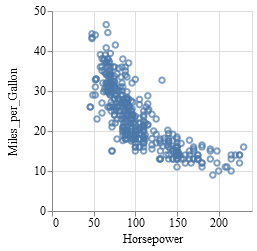

In [25]:
dataset("cars") |> @vlplot(:point,
    description="A scatterplot showing horsepower and miles per gallons for various cars.",
    enc={x="Horsepower:q",y="Miles_per_Gallon:q"}
)

#### Dot Plot

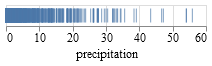

In [26]:
dataset("seattle-weather") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "tick",
  "encoding": {
    "x": {"field": "precipitation", "type": "quantitative"}
  }
}
"""

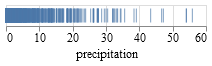

In [27]:
dataset("seattle-weather") |> @vlplot(:tick,enc={x="precipitation:q"})

#### Strip Plot

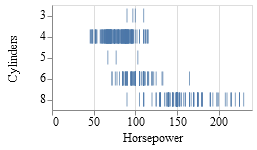

In [28]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Shows the relationship between horsepower and the numbver of cylinders using tick marks.",
  "mark": "tick",
  "encoding": {
    "x": {"field": "Horsepower", "type": "quantitative"},
    "y": {"field": "Cylinders", "type": "ordinal"}
  }
}
"""

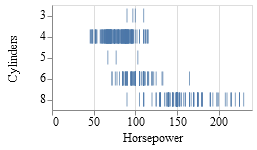

In [29]:
dataset("cars") |> @vlplot(:tick,enc={x="Horsepower:q",y="Cylinders:o"})

#### Colored Scatterplot

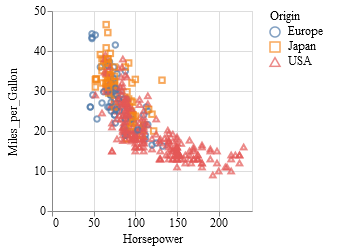

In [30]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A scatterplot showing horsepower and miles per gallons.",
  "mark": "point",
  "encoding": {
    "x": {"field": "Horsepower", "type": "quantitative"},
    "y": {"field": "Miles_per_Gallon", "type": "quantitative"},
    "color": {"field": "Origin", "type": "nominal"},
    "shape": {"field": "Origin", "type": "nominal"}
  }
}
"""

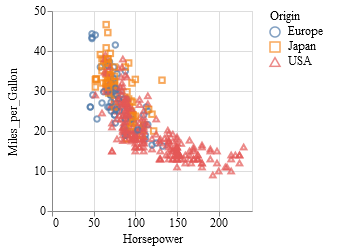

In [31]:
dataset("cars") |> @vlplot(:point,enc={x="Horsepower:q",y="Miles_per_Gallon:q",color="Origin:n",shape="Origin:n"})

#### Binned Scatterplot

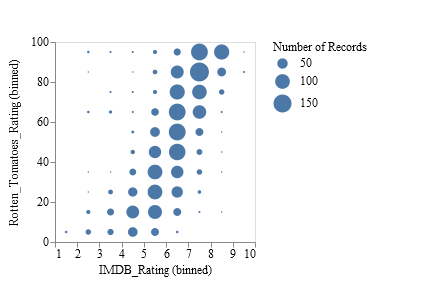

In [32]:
dataset("movies") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "circle",
  "encoding": {
    "x": {
      "bin": {"maxbins": 10},
      "field": "IMDB_Rating",
      "type": "quantitative"
    },
    "y": {
      "bin": {"maxbins": 10},
      "field": "Rotten_Tomatoes_Rating",
      "type": "quantitative"
    },
    "size": {
      "aggregate": "count",
      "type": "quantitative"
    }
  }
}
"""

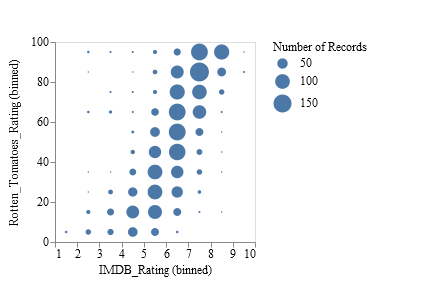

In [33]:
dataset("movies") |> @vlplot(:circle,enc={
    x={"IMDB_Rating:q",bin={maxbins=10}},
    y={"Rotten_Tomatoes_Rating:q",bin={maxbins=10}},
    size="count():q"
    })

#### Bubble Plot

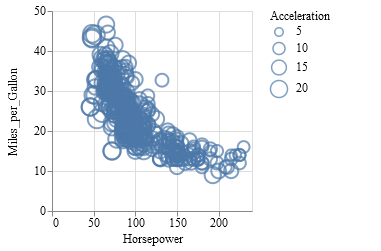

In [34]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A bubbleplot showing horsepower on x, miles per gallons on y, and binned acceleration on size.",
  "mark": "point",
  "encoding": {
    "x": {"field": "Horsepower", "type": "quantitative"},
    "y": {"field": "Miles_per_Gallon", "type": "quantitative"},
    "size": {"field": "Acceleration", "type": "quantitative"}
  }
}
"""

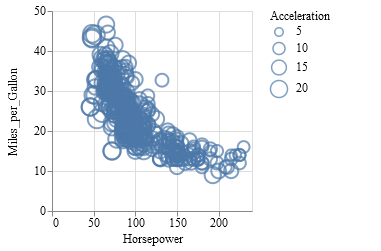

In [35]:
dataset("cars") |> @vlplot(:point,enc={x="Horsepower:q",y="Miles_per_Gallon:q",size="Acceleration:q"})

#### Scatterplot with Null Values in Grey

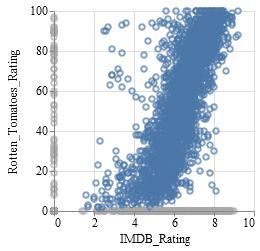

In [36]:
dataset("movies") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "point",
  "encoding": {
    "x": {
      "field": "IMDB_Rating",
      "type": "quantitative"
    },
    "y": {
      "field": "Rotten_Tomatoes_Rating",
      "type": "quantitative"
    },
    "color": {
      "condition": {
        "test": "datum.IMDB_Rating === null || datum.Rotten_Tomatoes_Rating === null",
        "value": "#aaa"
      }
    }
  },
  "config": {
    "invalidValues": null
  }
}
"""

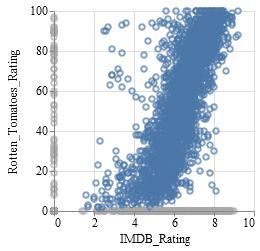

In [37]:
dataset("movies") |> @vlplot(:point,
    enc={
        x="IMDB_Rating:q",
        y="Rotten_Tomatoes_Rating:q",
        color={condition={test="datum.IMDB_Rating === null || datum.Rotten_Tomatoes_Rating === null",value="#aaa"}}
    },
    config={invalidValues=nothing}
)

#### Scatterplot with Filled Circles

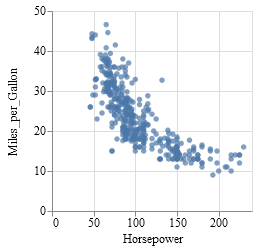

In [38]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "circle",
  "encoding": {
    "x": {"field": "Horsepower", "type": "quantitative"},
    "y": {"field": "Miles_per_Gallon", "type": "quantitative"}
  }
}
"""

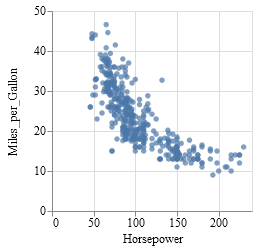

In [39]:
dataset("cars") |> @vlplot(:circle,enc={x="Horsepower:q",y="Miles_per_Gallon:q"})

#### Bubble Plot (Gapminder)

WARN Can not resolve event source: window
WARN Can not resolve event source: window


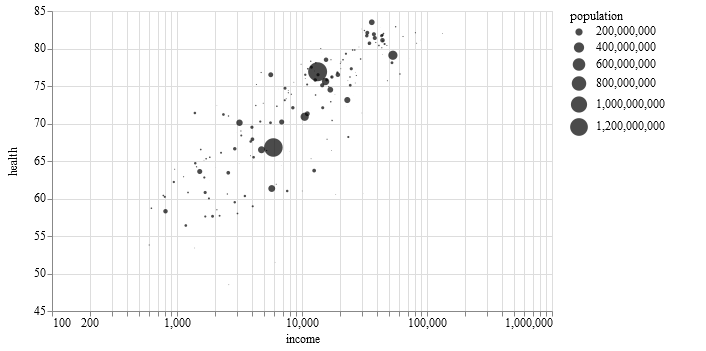

In [40]:
dataset("gapminder-health-income") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A bubble plot showing the correlation between health and income for 187 countries in the world (modified from an example in Lisa Charlotte Rost's blog post 'One Chart, Twelve Charting Libraries' --http://lisacharlotterost.github.io/2016/05/17/one-chart-code/).",
  "width": 500,"height": 300,
  "selection": {
    "view": {"type": "interval", "bind": "scales"}
  },
  "mark": "circle",
  "encoding": {
    "y": {
      "field": "health",
      "type": "quantitative",
      "scale": {"zero": false}
    },
    "x": {
      "field": "income",
      "type": "quantitative",
      "scale": {"type": "log"}
    },
    "size": {"field": "population","type": "quantitative"},
    "color": {"value": "#000"}
  }
}
"""

WARN Can not resolve event source: window
WARN Can not resolve event source: window
WARN Can not resolve event source: window
WARN Can not resolve event source: window


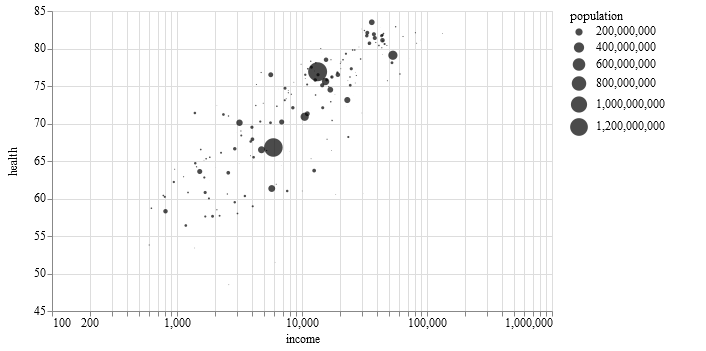

In [41]:
dataset("gapminder-health-income") |> @vlplot(:circle,
    width=500,height=300,
    selection={view={typ=:interval,bind=:scales}},
    enc={
        y={"health:q",scale={zero=false}},
        x={"income:q",scale={typ=:log}},
        size="population:q",
        color={value="#000"}
    }
)

#### Bubble Plot (Natural Disasters)

WARN Can not resolve event source: window
WARN Can not resolve event source: window


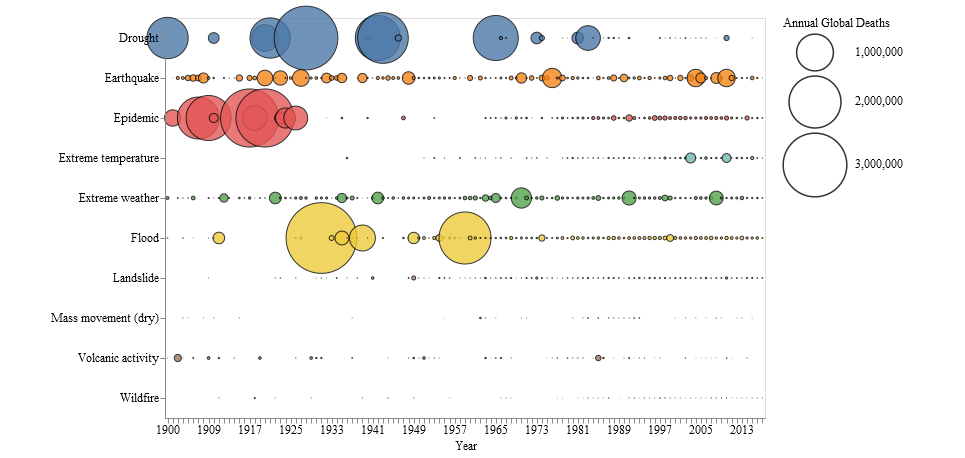

In [42]:
dataset("disasters") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "width": 600,
  "height": 400,
  "transform": [
    {"filter": "datum.Entity !== 'All natural disasters'"}
  ],
  "mark": {
    "type": "circle",
    "opacity": 0.8,
    "stroke": "black",
    "strokeWidth": 1
  },
  "encoding": {
    "x": {
      "field": "Year",
      "type": "ordinal",
      "axis": {"labelAngle": 0}
    },
    "y": {"field": "Entity", "type": "nominal", "axis": {"title": ""}},
    "size": {
      "field": "Deaths",
      "type": "quantitative",
      "legend": {"title": "Annual Global Deaths"},
      "scale": {"range": [0, 5000]}
    },
    "color": {"field": "Entity", "type": "nominal", "legend": null}
  }
}
"""

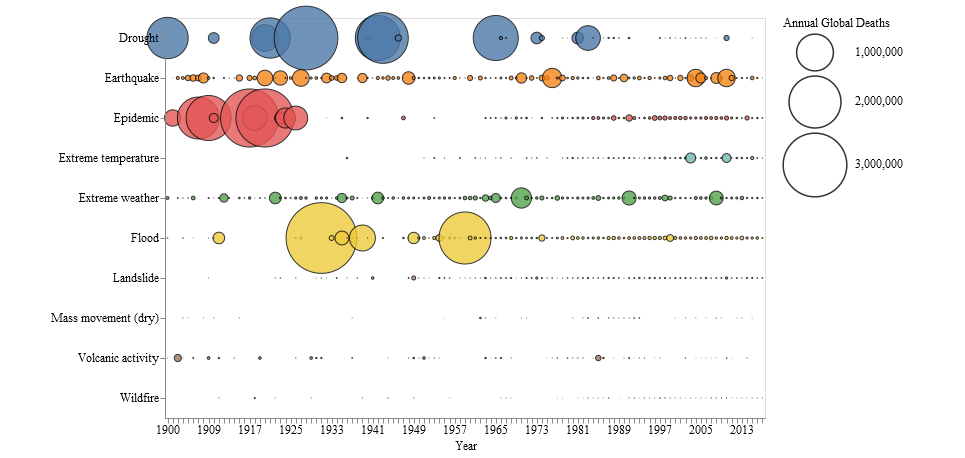

In [43]:
dataset("disasters") |> @vlplot(
    width=600,height=400,
    transform=[{filter="datum.Entity !== 'All natural disasters'"}],
    mark={:circle,opacity=0.8,stroke=:black,strokeWidth=1},
    enc={
        x={"Year:o",axis={labelAngle=0}},
        y={"Entity:n",axis={title=""}},
        size={"Deaths:q",legend={title="Annual Global Deaths"},scale={range=[0,5000]}},
        color={"Entity:n",legend=nothing}
    }
)

#### Scatter Plot with Text Marks

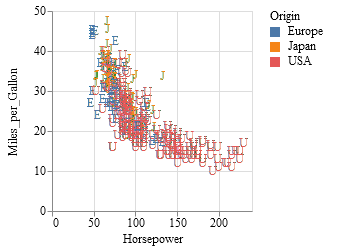

In [44]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "transform": [{
    "calculate": "datum.Origin[0]",
    "as": "OriginInitial"
  }],
  "mark": "text",
  "encoding": {
    "x": {"field": "Horsepower", "type": "quantitative"},
    "y": {"field": "Miles_per_Gallon", "type": "quantitative"},
    "color": {"field": "Origin", "type": "nominal"},
    "text": {"field": "OriginInitial", "type": "nominal"}
  }
}
"""

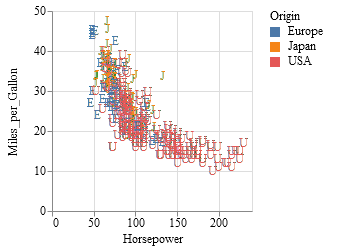

In [45]:
dataset("cars") |> @vlplot(:text,
    transform=[{
        calculate="datum.Origin[0]",
        as="OriginInitial"
    }],
    enc={x="Horsepower:q",y="Miles_per_Gallon:q",color="Origin:n",text="OriginInitial:n"}
)

### Line Charts

#### Line Chart

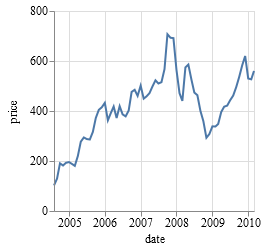

In [46]:
dataset("stocks") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Google's stock price over time.",
  "transform": [{"filter": "datum.symbol==='GOOG'"}],
  "mark": "line",
  "encoding": {
    "x": {"field": "date", "type": "temporal", "axis": {"format": "%Y"}},
    "y": {"field": "price", "type": "quantitative"}
  }
}
"""

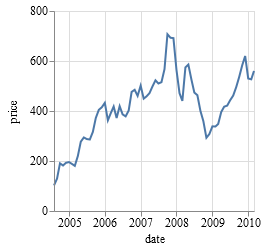

In [47]:
dataset("stocks") |> @vlplot(:line,
    transform=[
        {filter="datum.symbol=='GOOG'"}
    ],
    enc={x={"date:t",axis={format="%Y"}},y="price:q"}
)

#### Line Chart with Overlaying Point Markers

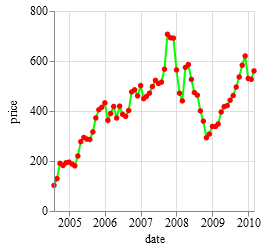

In [48]:
dataset("stocks") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Google's stock price over time.",
  "transform": [{"filter": "datum.symbol==='GOOG'"}],
  "mark": {"type": "line", "color": "green", "point": {"color": "red"}},
  "encoding": {
    "x": {"field": "date", "type": "temporal"},
    "y": {"field": "price", "type": "quantitative"}
  }
}
"""

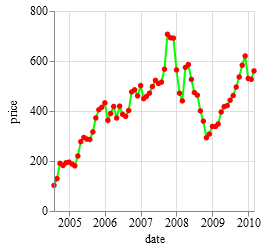

In [49]:
dataset("stocks") |> @vlplot(
    transform=[{filter="datum.symbol==='GOOG'"}],
    mark={:line,color=:green,point={color=:red}},
    enc={x="date:t",y="price:q"}
)

#### Multi Series Line Chart

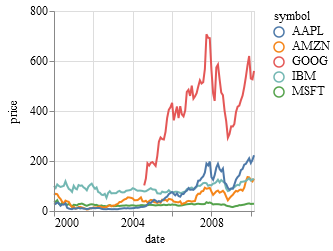

In [50]:
dataset("stocks") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Stock prices of 5 Tech Companies over Time.",
  "mark": "line",
  "encoding": {
    "x": {"field": "date", "type": "temporal", "axis": {"format": "%Y"}},
    "y": {"field": "price", "type": "quantitative"},
    "color": {"field": "symbol", "type": "nominal"}
  }
}
"""

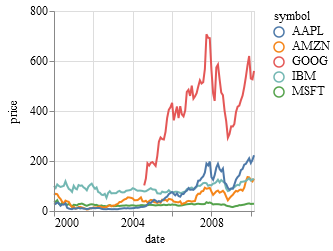

In [51]:
dataset("stocks") |> @vlplot(:line,enc={x={"date:t",axis={format="%Y"}},y="price:q",color="symbol:n"})

#### Slope Graph

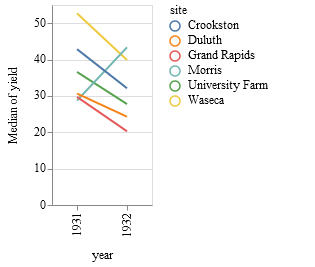

In [52]:
dataset("barley") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Slope graph showing the change in yield for different barley sites. It shows the error in the year labels for the Morris site.",
  "mark": "line",
  "encoding": {
    "x": {
      "field": "year",
      "type": "ordinal",
      "scale": {"rangeStep": 50, "padding": 0.5}
    },
    "y": {
      "aggregate": "median",
      "field": "yield",
      "type": "quantitative"
    },
    "color": {"field": "site", "type": "nominal"}
  }
}
"""

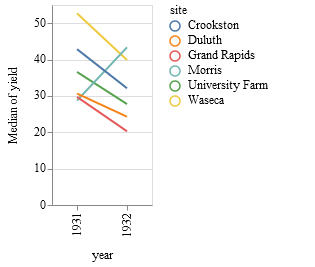

In [53]:
dataset("barley") |> @vlplot(:line,
    enc={
        x={"year:o",scale={rangeStep=50,padding=0.5}},
        y="median(yield):q",
        color="site:n"
    }
)

#### Step Chart

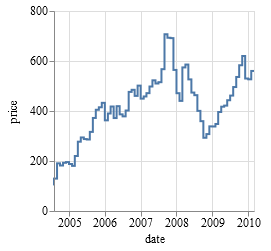

In [54]:
dataset("stocks") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Google's stock price over time.",
  "transform": [{"filter": "datum.symbol==='GOOG'"}],
  "mark": {
    "type": "line",
    "interpolate": "step-after"
  },
  "encoding": {
    "x": {"field": "date", "type": "temporal"},
    "y": {"field": "price", "type": "quantitative"}
  }
}
"""

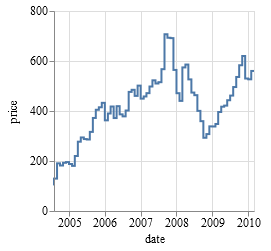

In [55]:
dataset("stocks") |> @vlplot(
    transform=[{filter="datum.symbol==='GOOG'"}],
    mark={:line,interpolate="step-after"},
    enc={x="date:t",y="price:q"}
)

#### Line Chart with Monotone Interpolation

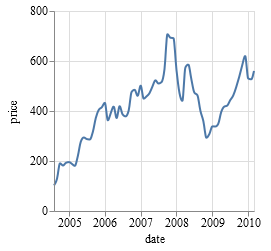

In [56]:
dataset("stocks") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "transform": [{"filter": "datum.symbol==='GOOG'"}],
  "mark": {
    "type": "line",
    "interpolate": "monotone"
  },
  "encoding": {
    "x": {"field": "date", "type": "temporal"},
    "y": {"field": "price", "type": "quantitative"}
  }
}
"""

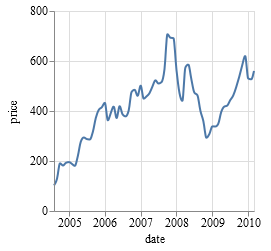

In [57]:
dataset("stocks") |> @vlplot(
    transform=[{filter="datum.symbol==='GOOG'"}],
    mark={:line,interpolate="monotone"},
    enc={x="date:t",y="price:q"}
)

#### Connected Scatterplot (Lines with Custom Paths)

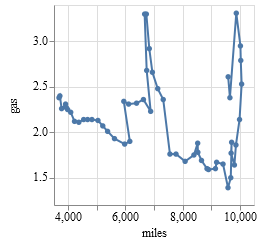

In [58]:
dataset("driving") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": {"type": "line", "point": true},
  "encoding": {
    "x": {
      "field": "miles", "type": "quantitative",
      "scale": {"zero": false}
    },
    "y": {
      "field": "gas", "type": "quantitative",
      "scale": {"zero": false}
    },
    "order": {"field": "year","type": "temporal"}
  }
}
"""

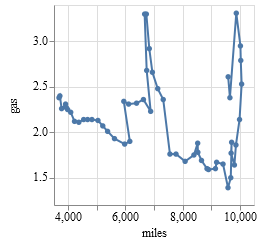

In [59]:
dataset("driving") |> @vlplot(
    mark={:line,point=true},
    enc={
        x={"miles:q",scale={zero=false}},
        y={"gas:q",scale={zero=false}},
        order="year:t"
    }
)

#### Line Chart with Varying Size (using the trail mark)

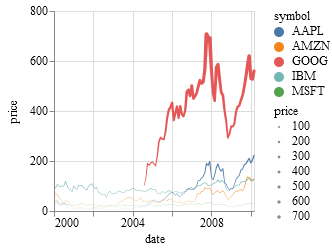

In [60]:
dataset("stocks") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Stock prices of 5 Tech Companies over Time.",
  "mark": "trail",
  "encoding": {
    "x": {
      "field": "date",
      "type": "temporal",
      "axis": {
        "format": "%Y"
      }
    },
    "y": {
      "field": "price",
      "type": "quantitative"
    },
    "size": {
      "field": "price",
      "type": "quantitative"
    },
    "color": {
      "field": "symbol",
      "type": "nominal"
    }
  }
}
"""

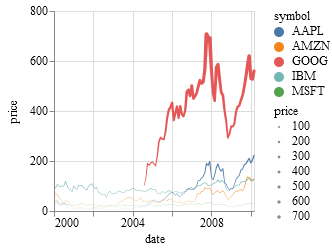

In [61]:
dataset("stocks") |> @vlplot(:trail,
    enc={
        x={"date:t",axis={format="%Y"}},
        y="price:q",
        size="price:q",
        color="symbol:n"
    }
)

#### Line Chart with Markers and Invalid Values

WARN Cannot clearly determine orientation for "line" since both x and y channel encode continuous fields. In this case, we use vertical by default
WARN Cannot clearly determine orientation for "line" since both x and y channel encode continuous fields. In this case, we use vertical by default


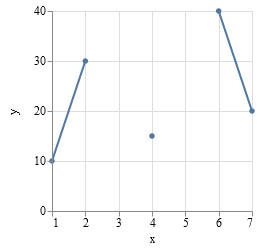

In [62]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "A simple bar chart with embedded data.",
  "data": {
    "values": [
      {
        "x": 1,
        "y": 10
      },
      {
        "x": 2,
        "y": 30
      },
      {
        "x": 3,
        "y": null
      },
      {
        "x": 4,
        "y": 15
      },
      {
        "x": 5,
        "y": null
      },
      {
        "x": 6,
        "y": 40
      },
      {
        "x": 7,
        "y": 20
      }
    ]
  },
  "mark": {"type": "line", "point": true},
  "encoding": {
    "x": {"field": "x", "type": "quantitative"},
    "y": {"field": "y", "type": "quantitative"}
  }
}
"""

WARN Cannot clearly determine orientation for "line" since both x and y channel encode continuous fields. In this case, we use vertical by default
WARN Cannot clearly determine orientation for "line" since both x and y channel encode continuous fields. In this case, we use vertical by default


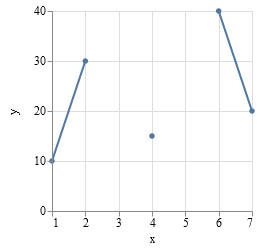

In [63]:
data = DataFrame(
    x=[1,2,3,4,5,6,7],
    y=[10,30,missing,15,missing,40,20]
)

data |>
@vlplot(
    mark={
        :line,
        point=true
    },
    x=:x,
    y=:y
)

#### Line Chart with Square Stroke Cap and Invalid Values (TODO)

#### Carbon Dioxide in the Atmosphere

WARN Cannot clearly determine orientation for "line" since both x and y channel encode continuous fields. In this case, we use vertical by default
WARN Cannot clearly determine orientation for "line" since both x and y channel encode continuous fields. In this case, we use vertical by default


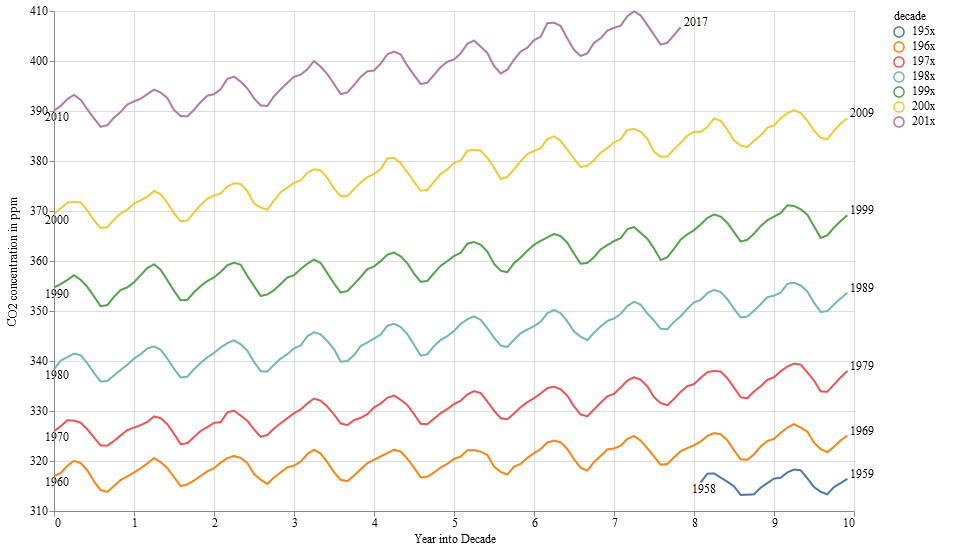

In [64]:
@vlplot(
    data={
        url=dataset("co2-concentration").path,
        format={
            parse={Date="utc:'%Y-%m-%d'"}
        }
    },
    width=800,
    height=500,
    transform=[
        {
            calculate="year(datum.Date)",
            as=:year
        },
        {
            calculate="month(datum.Date)",
            as=:month
        },
        {
            calculate="floor(datum.year / 10) + 'x'",
            as=:decade
        },
        {
            calculate="(datum.year % 10) + (datum.month/12)",
            as=:scaled_date
        }
    ]
) +
@vlplot(
    :line,
    x={
        "scaled_date:q",
        axis={
            title="Year into Decade",
            tickCount=11
        }
    },
    y={
        "CO2:q",
        axis={title="CO2 concentration in ppm"},
        scale={zero=false}
    },
    detail="decade:o",
    color={"decade:n", legend={offset=40}}
) +
(
    @vlplot(
        transform=[
            {
                aggregate=[{
                    op="argmin",
                    field="scaled_date",
                    as="start"
                }, {
                    op="argmax",
                    field="scaled_date",
                    as="end"
                }],
                groupby=["decade"]
            },
            {
                calculate="datum.start.scaled_date",
                as="scaled_date_start"
            },
            {
                calculate="datum.start.CO2",
                as="CO2_start"
            },
            {
                calculate="datum.start.year",
                as="year_start"
            },
            {
                calculate="datum.end.scaled_date",
                as="scaled_date_end"
            },
            {
                calculate="datum.end.CO2",
                as="CO2_end"
            },
            {
                calculate="datum.end.year",
                as="year_end"
            }
        ]
    ) +
    @vlplot(
        mark={
            :text,
            aligh=:left,
            baseline=:top,
            dx=3,
            dy=1
        },
        x="scaled_date_start:q",
        y="CO2_start:q",
        text="year_start:n"
    ) +
    @vlplot(
        mark={
            :text,
            align=:left,
            baseline=:bottom,
            dx=3,
            dy=1
        },
        x="scaled_date_end:q",
        y="CO2_end:q",
        text="year_end:n"
    )
)

#### Line Charts Showing Ranks Over Time (TODO)

WARN Cannot clearly determine orientation for "line" since both x and y channel encode discrete or empty fields.
WARN Specified orient "undefined" overridden with "vertical"
WARN Cannot clearly determine orientation for "line" since both x and y channel encode discrete or empty fields.
WARN Specified orient "undefined" overridden with "vertical"


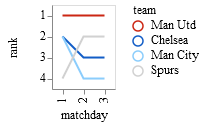

In [65]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Ranking of a hypothetical football/soccer league with 4 teams.",
  "data": {
    "values": [
      {"team": "Man Utd", "matchday": 1, "point": 3},
      {"team": "Chelsea", "matchday": 1, "point": 1},
      {"team": "Man City", "matchday": 1, "point": 1},
      {"team": "Spurs", "matchday": 1, "point": 0},
      {"team": "Man Utd", "matchday": 2, "point": 6},
      {"team": "Chelsea", "matchday": 2, "point": 1},
      {"team": "Man City", "matchday": 2, "point": 0},
      {"team": "Spurs", "matchday": 2, "point": 3},
      {"team": "Man Utd", "matchday": 3, "point": 9},
      {"team": "Chelsea", "matchday": 3, "point": 1},
      {"team": "Man City", "matchday": 3, "point": 0},
      {"team": "Spurs", "matchday": 3, "point": 6}
    ]
  },
  "transform": [{
    "sort": [{"field": "point", "order": "descending"}],
    "window": [{
      "op": "rank",
      "as": "rank"
    }],
    "groupby": ["matchday"]
  }],
  "mark": {"type": "line", "orient": "vertical"},
  "encoding": {
    "x": {"field": "matchday", "type": "ordinal"},
    "y": {"field": "rank", "type": "ordinal"},
    "color": {
      "field": "team", "type": "nominal",
      "scale": {
        "domain": ["Man Utd", "Chelsea", "Man City", "Spurs"],
        "range": ["#cc2613", "#125dc7", "#8bcdfc", "#d1d1d1"]
      }
    }
  }
}
"""

WARN Cannot clearly determine orientation for "line" since both x and y channel encode discrete or empty fields.
WARN Specified orient "undefined" overridden with "vertical"
WARN Cannot clearly determine orientation for "line" since both x and y channel encode discrete or empty fields.
WARN Specified orient "undefined" overridden with "vertical"


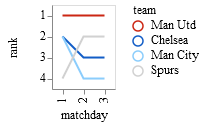

In [66]:
data = DataFrame(
    team=["Man Utd", "Chelsea", "Man City", "Spurs", "Man Utd", "Chelsea", "Man City", "Spurs", "Man Utd", "Chelsea", "Man City", "Spurs"],
    matchday=[1,1,1,1,2,2,2,2,3,3,3,3],
    point=[3,1,1,0,6,1,0,3,9,1,0,6]
)

data |>
@vlplot(
    transform=[{
        sort=[{field="point", order="descending"}],
        window=[{
            op="rank",
            as="rank"
        }],
        groupby=["matchday"]
    }],
    mark={
        :line,
        orient="vertical"
    },
    x="matchday:o",
    y="rank:o",
    color={
        :team,
        scale={
            domain=["Man Utd", "Chelsea", "Man City", "Spurs"],
            range=["#cc2613", "#125dc7", "#8bcdfc", "#d1d1d1"]
        }
    }
)

### Area Charts & Streamgraphs

#### Area Chart

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


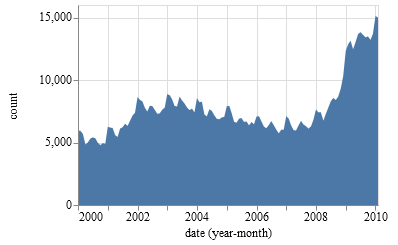

In [67]:
dataset("unemployment-across-industries") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "width": 300,
  "height": 200,
  "mark": "area",
  "encoding": {
    "x": {
      "timeUnit": "yearmonth", "field": "date", "type": "temporal",
      "axis": {"format": "%Y"}
    },
    "y": {
      "aggregate": "sum", "field": "count", "type": "quantitative",
      "axis": {"title": "count"}
    }
  }
}
"""

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


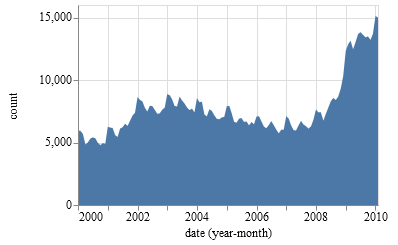

In [68]:
dataset("unemployment-across-industries") |>
@vlplot(
    :area,
    width=300, height=200,
    x={
        "yearmonth(date):t",
        axis={format="%Y"}
    },
    y={
        "sum(count)",
        axis={title="count"}
    }    
)

#### Area Chart with Overlaying Lines and Point Markers

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


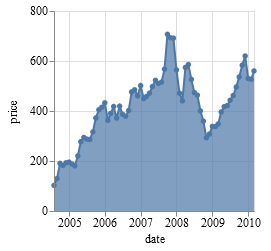

In [69]:
dataset("stocks") |>
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Google's stock price over time.",
  "transform": [{"filter": "datum.symbol==='GOOG'"}],
  "mark": {"type": "area", "line": true, "point": true},
  "encoding": {
    "x": {"field": "date", "type": "temporal"},
    "y": {"field": "price", "type": "quantitative"}
  }
}
"""

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


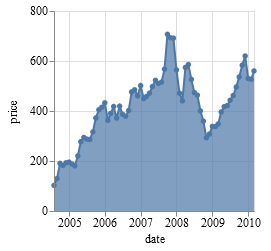

In [70]:
dataset("stocks") |>
@vlplot(
    transform=[{filter="datum.symbol==='GOOG'"}],
    mark={
        :area,
        line=true,
        point=true
    },
    x="date:t",
    y=:price
)

#### Stacked Area Chart

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


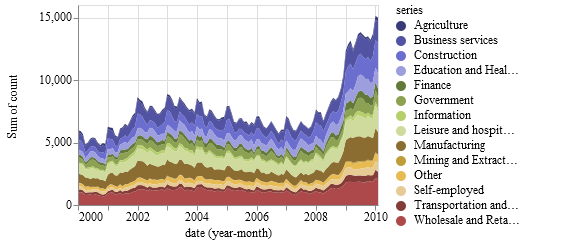

In [71]:
dataset("unemployment-across-industries") |>
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Area chart showing weight of cars over time.",
  "width": 300, "height": 200,
  "mark": "area",
  "encoding": {
    "x": {
      "timeUnit": "yearmonth", "field": "date", "type": "temporal",
      "axis": {"format": "%Y"}
    },
    "y": {
      "aggregate": "sum", "field": "count", "type": "quantitative"
    },
    "color": {
      "field": "series",
      "type": "nominal",
      "scale": {"scheme": "category20b"}
    }
  }
}
"""

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


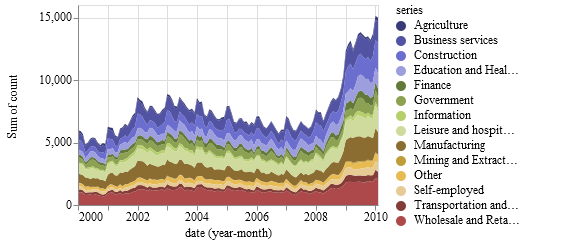

In [72]:
dataset("unemployment-across-industries") |>
@vlplot(
    :area,
    width=300, hieght=200,
    x={
        "yearmonth(date):t",
        axis={format="%Y"}
    },
    y="sum(count)",
    color={
        :series,
        scale={scheme="category20b"}
    }
)

#### Normalized Stacked Area Chart

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


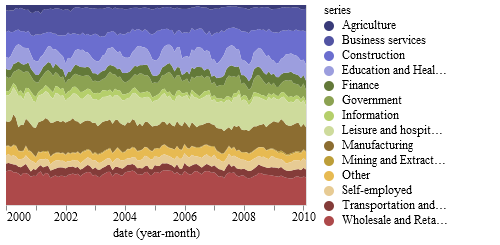

In [73]:
dataset("unemployment-across-industries") |>
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "width": 300, "height": 200,
  "mark": "area",
  "encoding": {
    "x": {
      "timeUnit": "yearmonth", "field": "date", "type": "temporal",
      "axis": {"domain": false, "format": "%Y"}
    },
    "y": {
      "aggregate": "sum", "field": "count","type": "quantitative",
      "axis": null,
      "stack": "normalize"

    },
    "color": {"field":"series", "type":"nominal", "scale":{"scheme": "category20b"}}
  }
}
"""

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


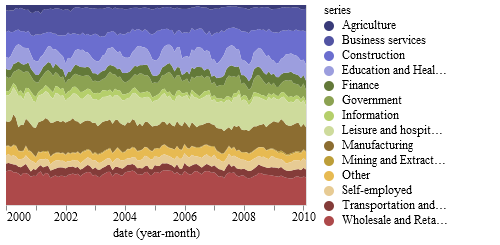

In [74]:
dataset("unemployment-across-industries") |>
@vlplot(
    :area,
    width=300, height=200,
    x={
        "yearmonth(date)",
        axis={
            domain=false,
            format="%Y"
        }
    },
    y={
        "sum(count)",
        axis=nothing,
        stack=:normalize
    },
    color={
        :series,
        scale={scheme="category20b"}
    }
)

#### Streamgraph

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


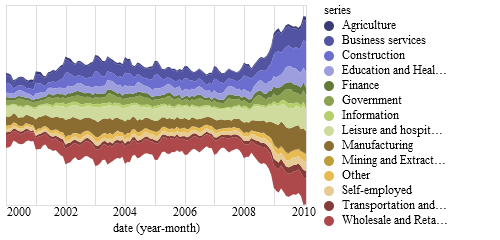

In [75]:
dataset("unemployment-across-industries") |>
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "width": 300, "height": 200,
  "mark": "area",
  "encoding": {
    "x": {
      "timeUnit": "yearmonth", "field": "date", "type": "temporal",
      "axis": {"domain": false, "format": "%Y", "tickSize": 0}
    },
    "y": {
      "aggregate": "sum", "field": "count","type": "quantitative",
      "axis": null,
      "stack": "center"
    },
    "color": {"field":"series", "type":"nominal", "scale":{"scheme": "category20b"}}
  }
}
"""

WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A time scale is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


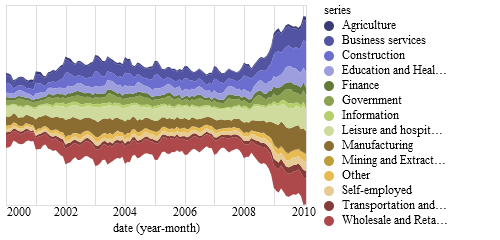

In [76]:
dataset("unemployment-across-industries") |>
@vlplot(
    :area,
    width=300, height=200,
    x={
        "yearmonth(date)",
        axis={
            domain=false,
            format="%Y",
            tickSize=0
        }
    },
    y={
        "sum(count)",
        axis=nothing,
        stack=:center
    },
    color={
        :series,
        scale={scheme="category20b"}
    }
)

#### Horizon Graph

WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.


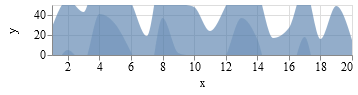

In [77]:
vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "description": "Horizon Graph with 2 layers. (See https://idl.cs.washington.edu/papers/horizon/ for more details on Horizon Graphs.)",
  "width": 300,
  "height": 50,
  "data": {
    "values": [
      {"x": 1,  "y": 28}, {"x": 2,  "y": 55},
      {"x": 3,  "y": 43}, {"x": 4,  "y": 91},
      {"x": 5,  "y": 81}, {"x": 6,  "y": 53},
      {"x": 7,  "y": 19}, {"x": 8,  "y": 87},
      {"x": 9,  "y": 52}, {"x": 10, "y": 48},
      {"x": 11, "y": 24}, {"x": 12, "y": 49},
      {"x": 13, "y": 87}, {"x": 14, "y": 66},
      {"x": 15, "y": 17}, {"x": 16, "y": 27},
      {"x": 17, "y": 68}, {"x": 18, "y": 16},
      {"x": 19, "y": 49}, {"x": 20, "y": 15}
    ]
  },
  "layer": [{
    "mark": {"type": "area", "clip": true, "orient": "vertical"},
    "encoding": {
      "x": {
        "field": "x", "type": "quantitative",
        "scale": {"zero": false, "nice": false}
      },
      "y": {
        "field": "y", "type": "quantitative",
        "scale": {"domain": [0,50]}
      },
      "opacity": {"value": 0.6}
    }
  }, {
    "transform": [
      {
        "calculate": "datum.y - 50",
        "as": "ny"
      }
    ],
    "mark": {"type": "area", "clip": true, "orient": "vertical"},
    "encoding": {
      "x": {
        "field": "x", "type": "quantitative"
      },
      "y": {
        "field": "ny", "type": "quantitative",
        "scale": {"domain": [0,50]},
        "axis": {"title": "y"}
      },
      "opacity": {"value": 0.3}
    }
  }],
  "config": {
    "area": {"interpolate": "monotone"}
  }
}

"""

WARN Invalid field type "undefined" for channel "x", using "quantitative" instead.
WARN Invalid field type "undefined" for channel "y", using "quantitative" instead.
WARN Invalid field type "undefined" for channel "x", using "quantitative" instead.
WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the scale domain. You may want to use point mark instead.
WARN Invalid field type "undefined" for channel "x", using "quantitative" instead.
WARN Invalid field type "undefined" for channel "y", using "quantitative" instead.
WARN Invalid field type "undefined" for channel "x", using "quantitative" instead.
WARN A scale with zero=false is used with area mark. This can be misleading as the width of the area can be arbitrary based on the s

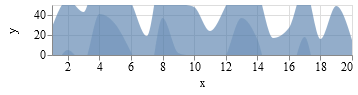

In [78]:
data = DataFrame(x=1:20, y=[28,55,43,91,81,53,19,87,52,48,24,49,87,66,17,27,68,16,49,15])

data |>
@vlplot(width=300, height=50, config={area={interpolate=:monotone}}) +
@vlplot(
    mark={
        :area,
        clip=true,
        orient=:vertical
    },
    x={:x, scale={zero=false, nice=false}},
    y={:y, scale={domain=[0,50]}},
    opacity={value=0.6}
) +
@vlplot(
    transform=[{calculate="datum.y-50", as=:ny}],
    mark={
        :area,
        clip=true,
        orient=:vertical
    },
    x=:x,
    y={
        "ny:q",
        scale={domain=[0,50]},
        axis={title="y"}
    },
    opacity={value=0.3}
)

### Table-based Plots

#### Table Heatmap

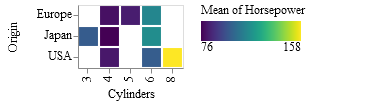

In [79]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "rect",
  "encoding": {
    "y": {"field": "Origin", "type": "nominal"},
    "x": {"field": "Cylinders", "type": "ordinal"},
    "color": {"aggregate": "mean", "field": "Horsepower", "type": "quantitative"}
  }
}
"""

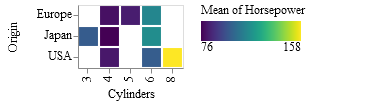

In [80]:
dataset("cars") |>
@vlplot(:rect, y=:Origin, x="Cylinders:o", color="mean(Horsepower)")

#### Table Binned heatmap

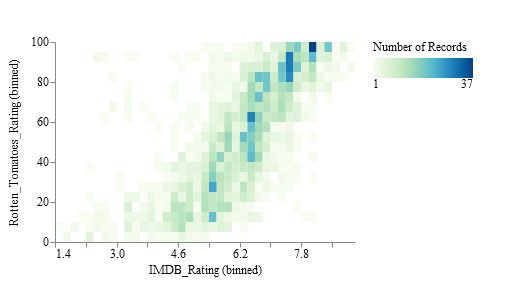

In [81]:
dataset("movies") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "rect",
  "width": 300,
  "height": 200,
  "encoding": {
    "x": {
      "bin": {"maxbins":60},
      "field": "IMDB_Rating",
      "type": "quantitative"
    },
    "y": {
      "bin": {"maxbins": 40},
      "field": "Rotten_Tomatoes_Rating",
      "type": "quantitative"
    },
    "color": {
      "aggregate": "count",
      "type": "quantitative"
    }
  },
  "config": {
    "range": {
      "heatmap": {
        "scheme": "greenblue"
      }
    },
    "view": {
      "stroke": "transparent"
    }
  }
}
"""

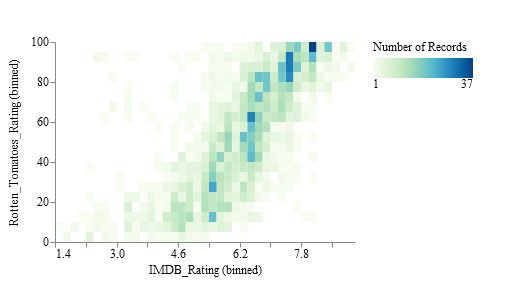

In [82]:
dataset("movies") |>
@vlplot(
    :rect,
    width=300, height=200,
    x={:IMDB_Rating, bin={maxbins=60}},
    y={:Rotten_Tomatoes_Rating, bin={maxbins=40}},
    color="count()",
    config={
        range={
            heatmap={
                scheme="greenblue"
            }
        },
        view={
            stroke="transparent"
        }
    }
)

#### Table Bubble Plot (Github Punch Card)

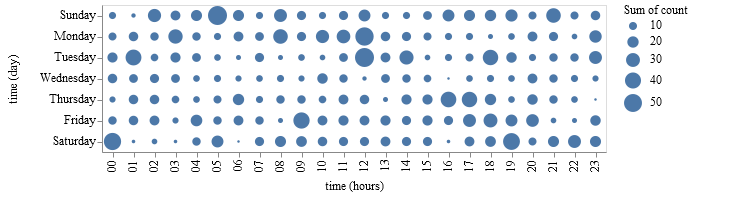

In [83]:
dataset("github") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "mark": "circle",
  "encoding": {
    "y": {
      "field": "time",
      "type": "ordinal",
      "timeUnit": "day"
    },
    "x": {
      "field": "time",
      "type": "ordinal",
      "timeUnit": "hours"
    },
    "size": {
      "field": "count",
      "type": "quantitative",
      "aggregate": "sum"
    }
  }
}
"""

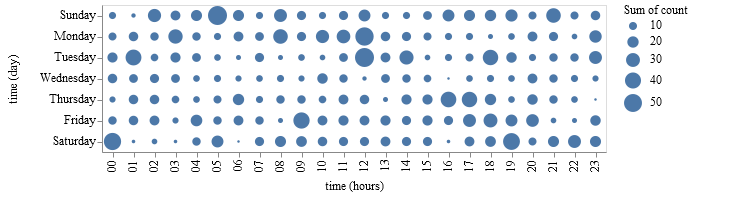

In [84]:
dataset("github") |>
@vlplot(
    :circle,
    y="day(time):o",
    x="hours(time):o",
    size="sum(count)"
)

#### Layering text over heatmap

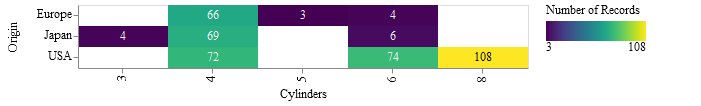

In [85]:
dataset("cars") |> vl"""
{
  "$schema": "https://vega.github.io/schema/vega-lite/v2.json",
  "encoding": {
    "y": {"field": "Origin", "type": "ordinal"},
    "x": {"field": "Cylinders", "type": "ordinal"}
  },
  "layer": [{
    "mark": "rect",
    "encoding": {
      "color":  {"aggregate": "count", "field": "*", "type": "quantitative"}
    }
  }, {
    "mark": "text",
    "encoding": {
      "text": {"aggregate": "count", "field": "*", "type": "quantitative"},
      "color": {
        "condition": {"test": "datum['count_*'] > 100", "value": "black"},
        "value": "white"
      }
    }
  }],
  "config": {
    "scale": {"bandPaddingInner": 0, "bandPaddingOuter": 0},
    "text": {"baseline": "middle"}
  }
}
"""

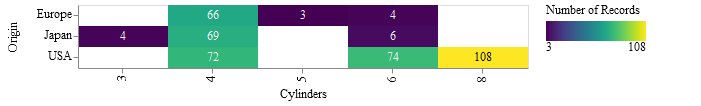

In [86]:
cars = dataset("cars")

@vlplot(
    data=cars,
    y="Origin:o",
    x="Cylinders:o",
    config={
        scale={bandPaddingInner=0, bandPaddingOuter=0},
        text={baseline=:middle}
    }
) +
@vlplot(:rect, color="count()") +
@vlplot(
    :text,
    text="count()",
    color={
        condition={
            test="datum['count_*'] > 100",
            value=:black
        },
        value=:white
    }
)